Before executing any cell: Runtime > Change runtime type > Select "GPU" under Hardware accelerator > Save

In [ ]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



Researched different pre-trained networks that showed good performance on 'oriented object detection' task

# Installing packages

In [ ]:
!pip install tensorflow[and-cuda]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 875.6/875.6 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.9/417.9 MB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.4/168.4 MB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 728.5/728.5 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.1/58.1 MB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.2/128.2 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.1/204.1 MB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.3/210.3 MB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 76.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.5/19.5 MB 72.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.5/549.5 MB 3.0 MB/s eta 0:00:00


In [ ]:
# Install pytorch with older cuda version (<= 11.7) to avoid error with mmcv-full install
!pip3 install torch==2.0.0+cu117 torchvision==0.15.1+cu117 --index-url https://download.pytorch.org/whl/cu117

Looking in indexes: https://download.pytorch.org/whl/cu117
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 GB 781.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 51.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 MB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.3/132.3 kB 17.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lit: filename=lit-15.0.7-py3-none-any.whl size=89989 sha256=448fff506721c1e17c93e4e85ca942e1a87f9980f0e1183704cdca403a636666
  Stored in directory: /root/.cache/pip/wheels/27/2c/b6/3ed2983b1b44fe0dea1bb35234b09f2c22fb8ebb308679c922
Successfully built lit
  Attempting uninstall: triton
    Found existing installation: triton 2.1.0
    Uninstalling triton-2.1.0:
      Successfully uninstalled triton-2.1.0
  Attempting uninstall: torch
    Found existing installation: torch 2.1.0+cu118
    Uninstalling torch-2.1.0+cu118:
      Successfully uninstalled to

In [ ]:
# Install MMCV and MMDetection using MIM
!pip3 install -U openmim
!mim install "mmcv>=2.0.0" # time-consuming: can take at least 40 min
!mim install mmdet

# Install MMRotate from the source
!git clone https://github.com/open-mmlab/mmrotate.git
%cd mmrotate
!pip install -e .

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.4/297.4 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.5/259.5 kB 16.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.4/239.4 kB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.1/953.1 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.8/143.8 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.7/89.7 kB 12.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.0/94.0 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━

Looking in links: https://download.openmmlab.com/mmcv/dist/cu117/torch2.0.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.5/98.5 MB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 450.3/450.3 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 8.2 MB/s eta 0:00:00
Looking in links: https://download.openmmlab.com/mmcv/dist/cu117/torch2.0.0/index.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 14.3 MB/s eta 0:00:00
Cloning into 'mmrotate'...
remote: Enumerating objects: 3853, done.
remote: Counting objects: 100% (1266/1266), done.
remote: Compressing objects: 100% (391/391), done.
remote: Total 3853 (delta 973), reused 900 (delta 875), pack-reused 2587
Receiving objects: 100% (3853/3853), 25.29 MiB | 13.81 MiB/s, done.
Resolving deltas: 100% (2367/2367), done.
/content/mmrotate
Obtaining file:///content/mmrotate
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 225.3/225.3

In [ ]:
from mmcv import collect_env
collect_env()
import mmcv

# Check MMRotate installation
import mmrotate
print(f"mmrotate {mmrotate.__version__}")

# Check MMDetection installation
import mmdet
print(f"mmdet {mmdet.__version__}")

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

/usr/local/lib/python3.10/dist-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


mmrotate 0.3.4
mmdet 2.28.2
11.8
GCC 11.4


In [ ]:
# Clone repo with image data
!git clone https://gitlab.com/mckenzie-intelligence/recruiting/data.git

Cloning into 'data'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (44/44), done.
remote: Total 49 (delta 9), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (49/49), 8.14 MiB | 17.65 MiB/s, done.
Resolving deltas: 100% (9/9), done.


In [ ]:
import glob
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path

import torch

# Data I/O

In [ ]:
root = Path("/content/data/Data Science/Building Footprint Detection and Damage Assessment/")

In [ ]:
# Get all image filepaths
img_paths = sorted((root / "data").glob("*.jp*"))
img_paths

[PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_1.jpeg'),
 PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_2.jpg'),
 PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_3.jpeg'),
 PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_4.jpeg'),
 PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_5.jpeg'),
 PosixPath('/content/data/Data Science/Building Footprint Detection and Damage Assessment/data/image_6.jpeg')]

In [ ]:
# Read and store .jpg - 'bgr' order
images = []
for p in img_paths:
    images.append(mmcv.imread(p))

In [ ]:
# Check image dimensions
for i in images:
    print(i.shape)

(600, 960, 3)
(893, 1368, 3)
(815, 1280, 3)
(1147, 2046, 3)
(5619, 9569, 3)
(1155, 1920, 3)


# Image vis & processing

In [ ]:
import cv2

In [ ]:
def sharpen(images, img_paths):
  """Custom function that sharpens an image using a 3x3 edge filter kernel"""
  for img, path in zip(images, img_paths):
    fig, axs = plt.subplots(1, 2, figsize=(16,9))
    axs[0].set_title("orig")
    axs[0].imshow(img)

    # Sharpen using an edge kernel
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened1 = cv2.filter2D(img, -1, kernel)

    # Sharpen the image using the Laplacian operator
    # sharpened2 = cv2.Laplacian(img, cv2.CV_64F)

    # Save the image
    # cv2.imwrite(f'./sharpened/{path.stem}_sharpened.jpg', sharpened1)

    # Plot the sharpened images
    axs[1].set_title("kernel filter")
    axs[1].imshow(sharpened1)

    # axs[2].set_title("Laplacian")
    # axs[2].imshow(sharpened2)

    plt.show()

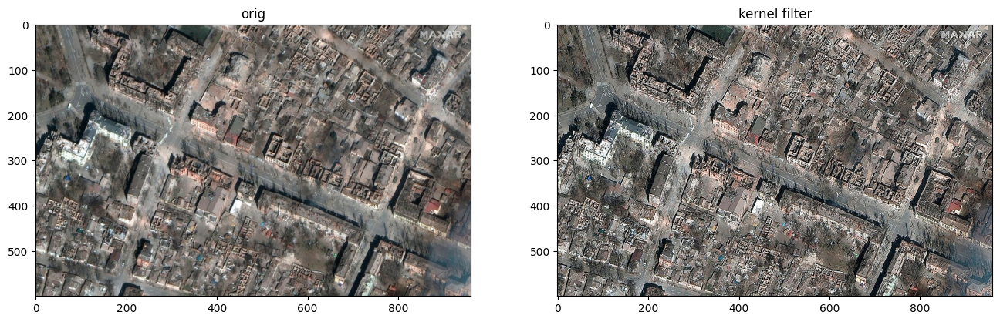

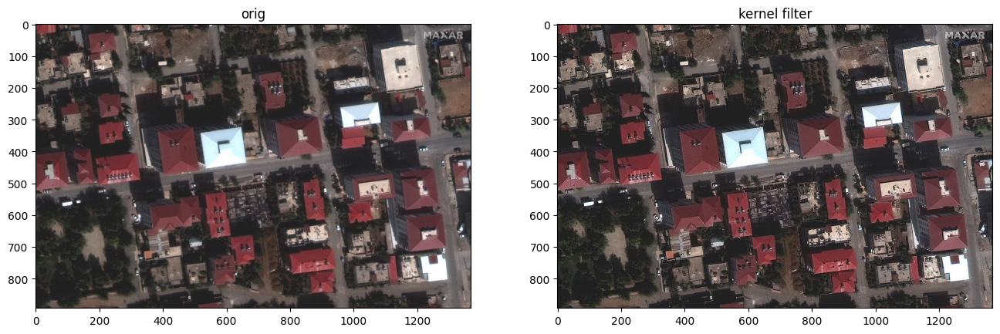

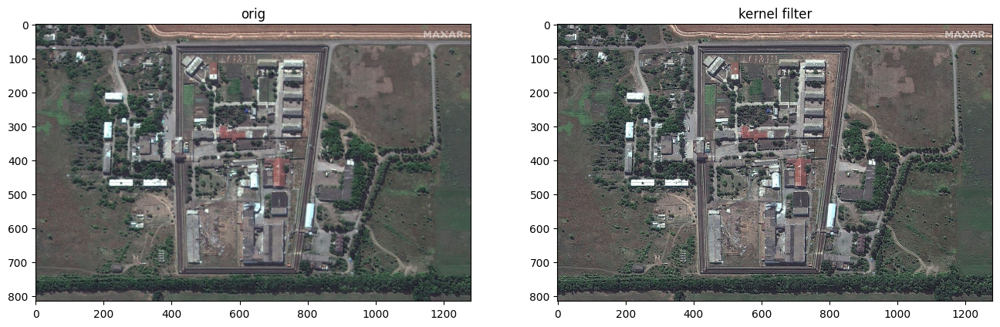

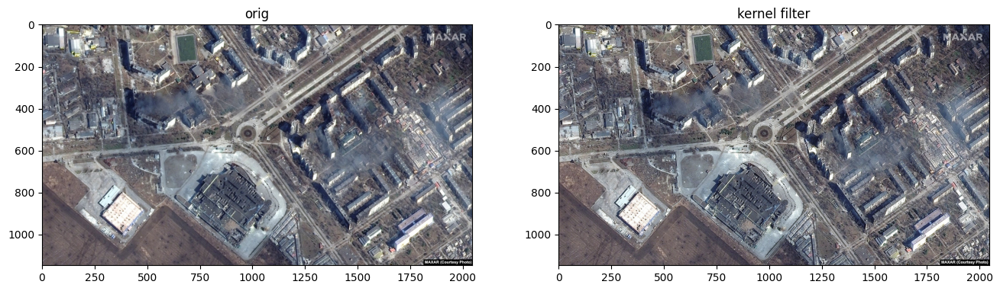

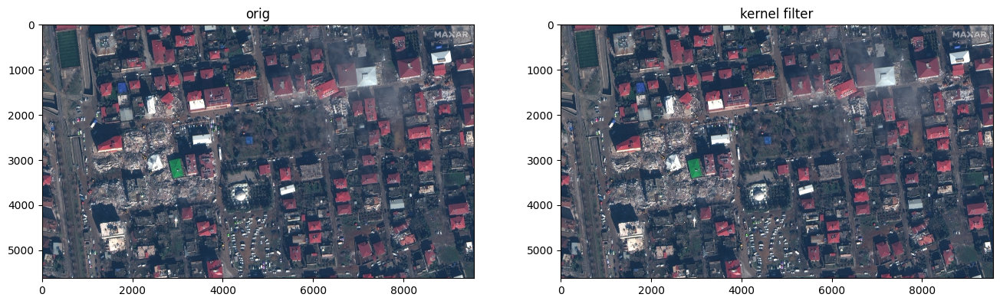

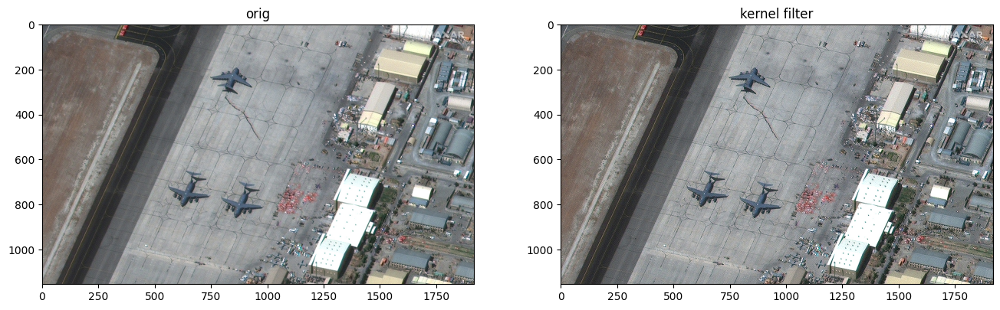

In [ ]:
sharpen(images, img_paths)

# Inference

In [ ]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmrotate.models import build_detector
from mmrotate.apis import inference_detector_by_patches

In [ ]:
# Use mim to download the pre-trained checkpoints for inference
!mim download mmrotate --config oriented_rcnn_r50_fpn_1x_dota_le90 --dest .

processing oriented_rcnn_r50_fpn_1x_dota_le90...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.1/158.1 MiB 12.4 MB/s eta 0:00:00
Successfully downloaded oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth to /content
Successfully dumped oriented_rcnn_r50_fpn_1x_dota_le90.py to /content


In [ ]:
# Download a different set of pre-trained checkpoints
!mim download mmrotate --config redet_re50_refpn_1x_dota_ms_rr_le90 --dest .

processing redet_re50_refpn_1x_dota_ms_rr_le90...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.0/125.0 MiB 9.0 MB/s eta 0:00:00
Successfully downloaded redet_re50_fpn_1x_dota_ms_rr_le90-fc9217b5.pth to /content
Successfully dumped redet_re50_refpn_1x_dota_ms_rr_le90.py to /content


In [ ]:
# Define config to initialize the detector
config = "oriented_rcnn_r50_fpn_1x_dota_le90.py"
# Define a checkpoint file to load
checkpoint = "oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth"

In [ ]:
# Different model config & checkpoint
config = "redet_re50_refpn_1x_dota_ms_rr_le90.py"
checkpoint = "redet_re50_fpn_1x_dota_ms_rr_le90-fc9217b5.pth"

In [ ]:
# Set the device to be used for evaluation
device='cuda:0'

# Load the config
config = mmcv.Config.fromfile(config)
# Set pretrained to be None since we are not using pretrained model here
config.model.pretrained = None

# Initialize the detector
model = build_detector(config.model)

# Load checkpoint
checkpoint = load_checkpoint(model, checkpoint, map_location=device)

# Set the classes of models for inference
model.CLASSES = checkpoint['meta']['CLASSES']

# We need to set the model's cfg for inference
model.cfg = config

# Convert the model to GPU and put in evaluation mode
model.to(device)
model.eval()

/content/mmrotate/mmrotate/models/backbones/re_resnet.py:481: UserWarning: DeprecationWarning: pretrained is deprecated, please use "init_cfg" instead
  warnings.warn('DeprecationWarning: pretrained is deprecated, '
/usr/local/lib/python3.10/dist-packages/e2cnn/nn/modules/r2_conv/basisexpansion_singleblock.py:80: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at ../aten/src/ATen/native/IndexingUtils.h:27.)
  full_mask[mask] = norms.to(torch.uint8)
/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:116: UserWarning: DeprecationWarning: `num_anchors` is deprecated, for consistency or also use `num_base_priors` instead
  warnings.warn('DeprecationWarning: `num_anchors` is deprecated, '


load checkpoint from local path: redet_re50_fpn_1x_dota_ms_rr_le90-fc9217b5.pth
The model and loaded state dict do not match exactly

missing keys in source state_dict: backbone.conv1.filter, backbone.layer2.0.conv1.filter, backbone.layer2.0.conv2.filter, backbone.layer2.0.conv3.filter, backbone.layer2.0.downsample.0.filter, backbone.layer2.1.conv1.filter, backbone.layer2.1.conv2.filter, backbone.layer2.1.conv3.filter, backbone.layer2.2.conv1.filter, backbone.layer2.2.conv2.filter, backbone.layer2.2.conv3.filter, backbone.layer2.3.conv1.filter, backbone.layer2.3.conv2.filter, backbone.layer2.3.conv3.filter, backbone.layer3.0.conv1.filter, backbone.layer3.0.conv2.filter, backbone.layer3.0.conv3.filter, backbone.layer3.0.downsample.0.filter, backbone.layer3.1.conv1.filter, backbone.layer3.1.conv2.filter, backbone.layer3.1.conv3.filter, backbone.layer3.2.conv1.filter, backbone.layer3.2.conv2.filter, backbone.layer3.2.conv3.filter, backbone.layer3.3.conv1.filter, backbone.layer3.3.conv2.fi

ReDet(
  (backbone): ReResNet(
    (conv1): R2Conv([8-Rotations: {irrep_0, irrep_0, irrep_0}], [8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}], kernel_size=7, stride=2, padding=3, bias=False)
    (bn1): InnerBatchNorm([8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}], eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=False, type=[8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}])
    (maxpool): PointwiseMaxPool()
    (layer1): ResLayer(
      (0): Bottleneck(
        (conv1): R2Conv([8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}], [8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}], kernel_size=1, stride=1, bias=False)
        (bn1): InnerBatchNorm([8-Rotations: {regular, regular, regular, regular, regular, regular, regular, regular}], eps=1e-05, momentum=0.1,

### Inference using pre-trained checkpoint: oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0

In [ ]:
result6 = inference_detector(model, img_paths[-1])

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


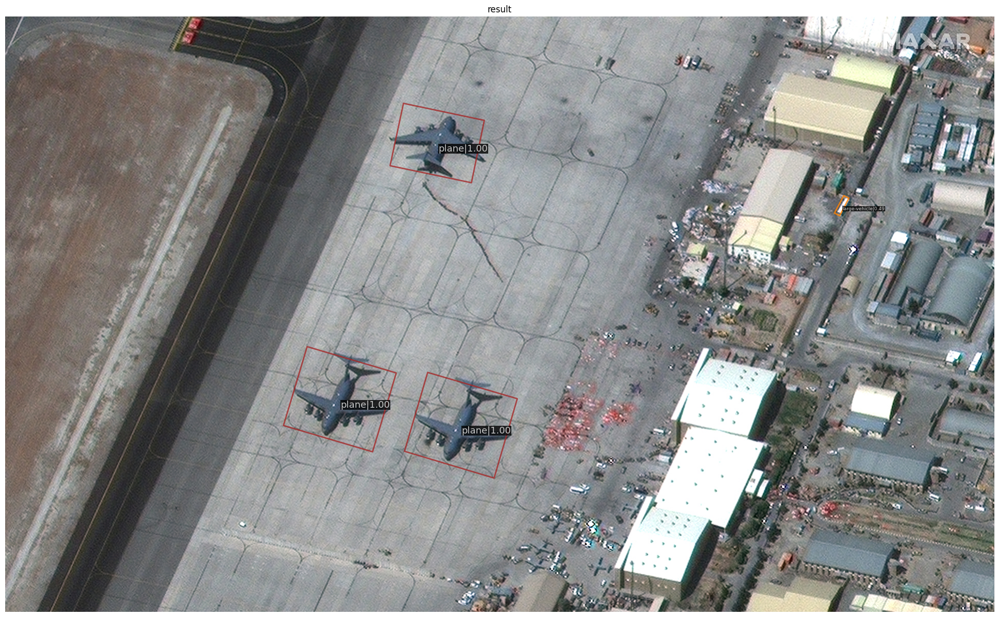

In [ ]:
# Plot the result
show_result_pyplot(model, img_paths[-1], result6, score_thr=0.3, palette='dota')

In [ ]:
result2 = inference_detector(model, img_paths[1])

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


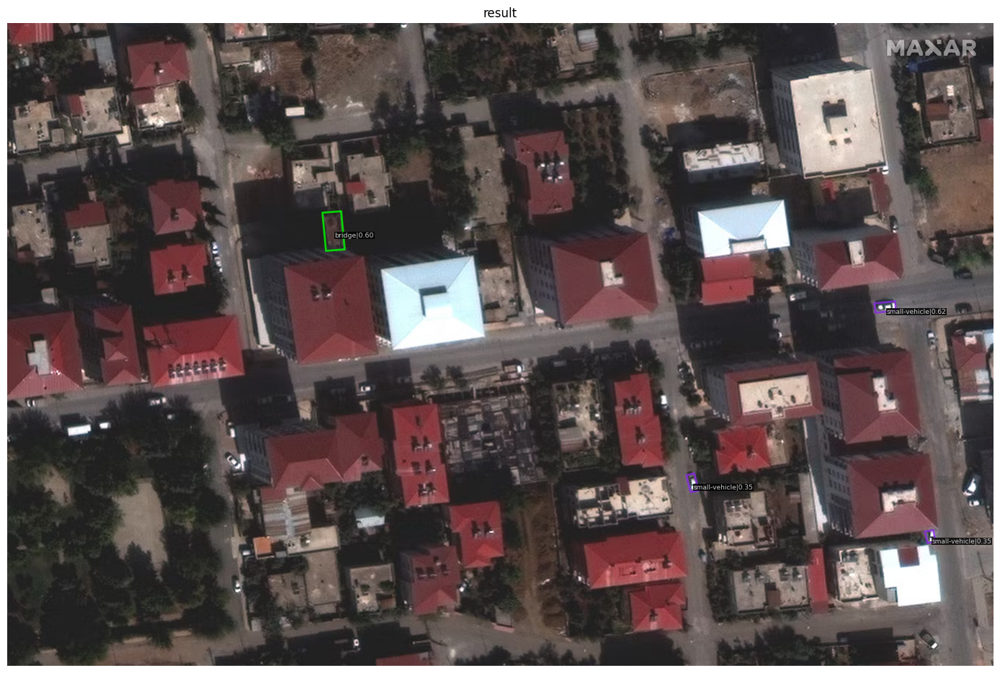

In [ ]:
show_result_pyplot(model, img_paths[1], result2, score_thr=0.3, palette='dota')

In [ ]:
result4 = inference_detector(model, img_paths[-3])

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


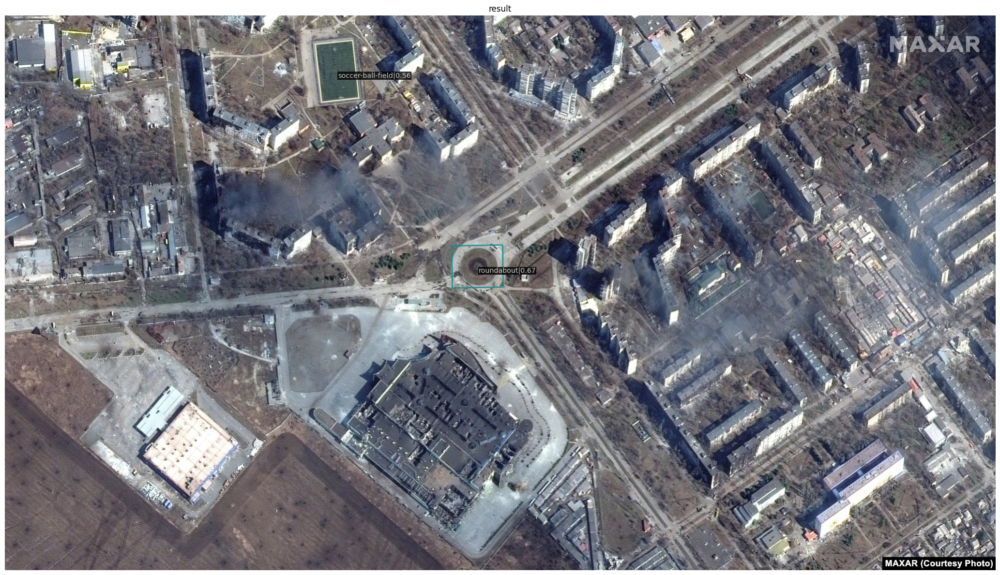

In [ ]:
show_result_pyplot(model, img_paths[-3], result4, score_thr=0.3, palette='dota')

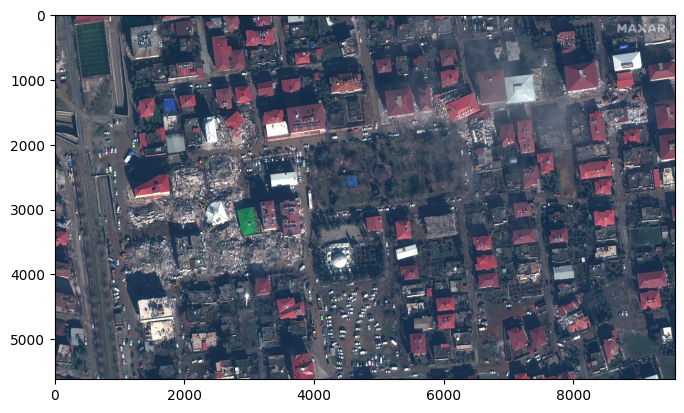

In [ ]:
plt.figure(figsize=(8,10))
plt.imshow(images[-2])
plt.show()

In [ ]:
result5 = inference_detector(model, img_paths[-2])

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


### Inference using pre-trained checkpoint: redet_re50_fpn_1x_dota_ms_rr_le90-fc9217b5

In [ ]:
result6 = inference_detector(model, img_paths[-1])

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '



*  Large planes correctly detected, but extremely small planes and vehicles ignored

*  Might be due to too drastic differences in size

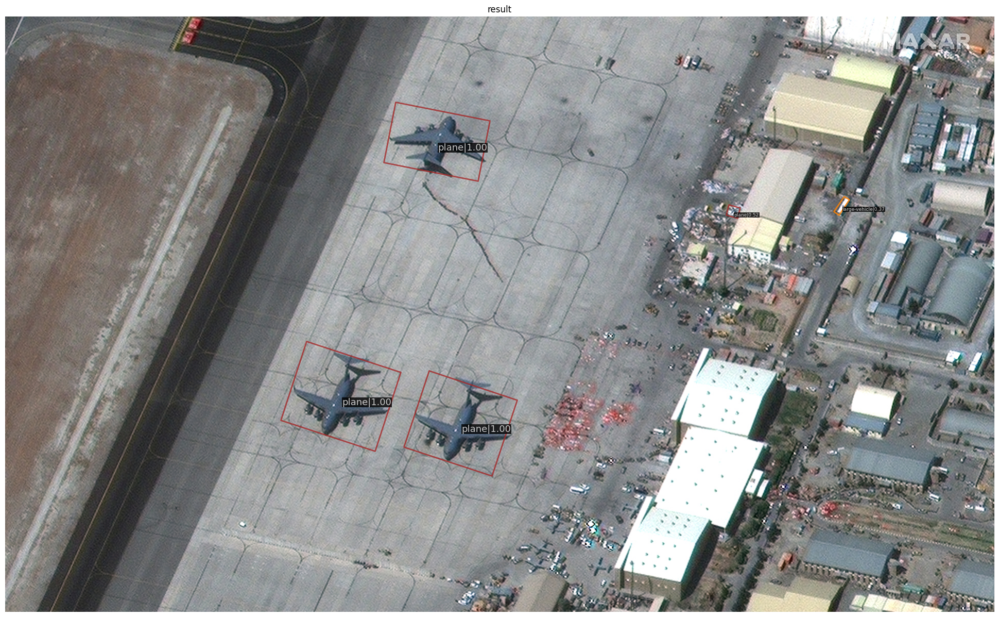

In [ ]:
show_result_pyplot(model, img_paths[-1], result6, score_thr=0.3, palette='dota')

In [ ]:
# Dividing image_6 into patches of 256x256 with 10px overlap
patch_result6 = inference_detector_by_patches(model, img_paths[-1], [256], [246], [1.0], 0.1)

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


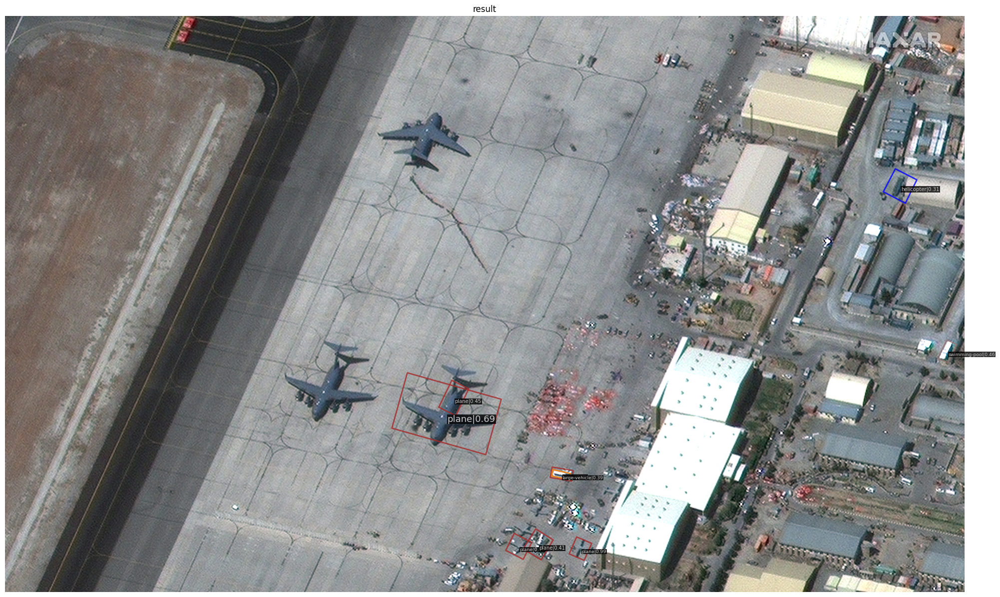

In [ ]:
show_result_pyplot(model, img_paths[-1], patch_result6, score_thr=0.3, palette='dota')

In [ ]:
patch_result5 = inference_detector_by_patches(model, img_paths[-2], [1024], [984], [1.0], 0.1)
show_result_pyplot(model, img_paths[-2], patch_result5, score_thr=0.3, palette='dota') # maybe size too big, doesn't want to show

/usr/local/lib/python3.10/dist-packages/mmdet/models/dense_heads/anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


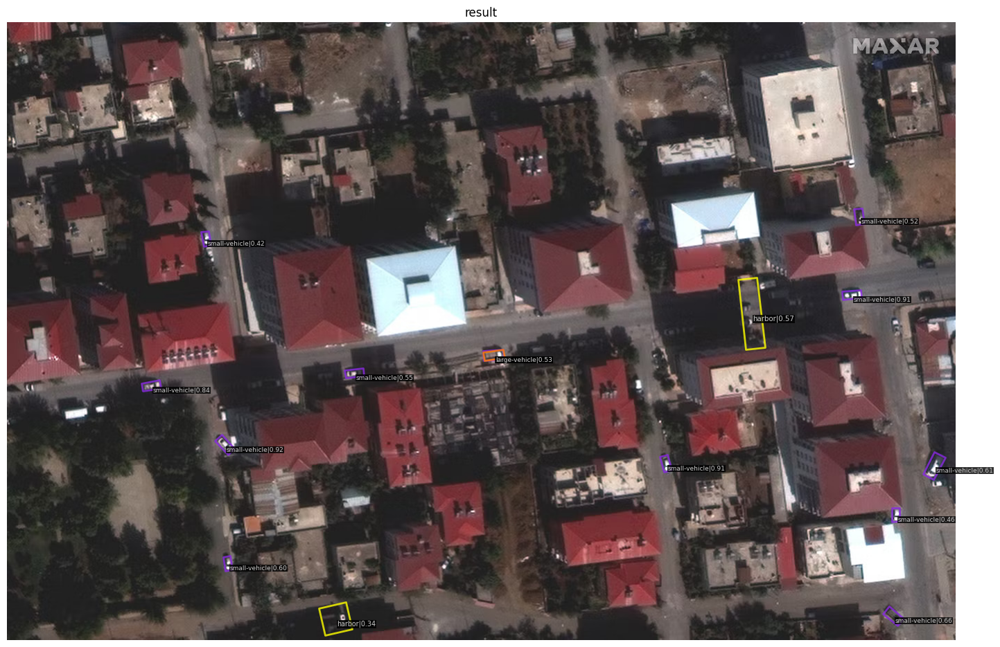

In [ ]:
# Divide image_2 into patches of 512x512 with a 20px overlap
patch_result2 = inference_detector_by_patches(model, img_paths[1], [512], [492], [1.0], 0.1)
show_result_pyplot(model, img_paths[1], patch_result2, score_thr=0.3, palette='dota')

Most small vehicles are correctly detected, a few are missed